# Simulated Annealing for SMA Optimization


This notebook demonstrates how to use Simulated Annealing to find an effective Simple Moving Average window for a trading rule. We fetch BTC daily data from EODHD, take a short slice for demonstration, explain the SMA mathematically, show pseudocode, implement a backtest, run simulated annealing, and visualize the search using plots and an animation.

In [44]:
%pip install python-dotenv requests pandas matplotlib numpy tqdm -q

Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Users\Brian\OneDrive - University of Witwatersrand\Desktop\off_the_grid\medium\articles\simulated_annealing_trading_optimization\.venv\Scripts\python.exe -m pip install --upgrade pip' command.


In [45]:
# %% Cell: Imports and API setup
import os
import requests
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()
api_key = os.getenv("EODHD_API_KEY")

In [46]:
# %% Cell: Parameters and data fetch
symbol = "AAPL"
from_date = "2024-01-01"
to_date = "2025-01-01"

url = (
    f"https://eodhd.com/api/eod/{symbol}"
    f"?api_token={api_key}"
    "&fmt=json"
    "&period=d"
    f"&from={from_date}"
    f"&to={to_date}"
)

print("Requesting data...")
data = requests.get(url).json()

# Build dataframe
df = pd.DataFrame(data)
if df.empty:
    raise ValueError("No data returned — check API key, symbol, or dates")

df["date"] = pd.to_datetime(df["date"])
df.set_index("date", inplace=True)
df.sort_index(inplace=True)

# Use adjusted close for calculations
prices = df["adjusted_close"].astype(float)
print(f"Data loaded: {len(prices)} rows. Range: {prices.index.min().date()} to {prices.index.max().date()}")

# Take last 120 days (roughly 6 months) for smoother animation
prices_short = prices.dropna().iloc[-120:]
print(f"Short slice length: {len(prices_short)}")

# Quick display
prices_short.head()

Requesting data...
Data loaded: 252 rows. Range: 2024-01-02 to 2024-12-31
Short slice length: 120


date
2024-07-12    229.2067
2024-07-15    233.0444
2024-07-16    233.4620
2024-07-17    227.5563
2024-07-18    222.8835
Name: adjusted_close, dtype: float64

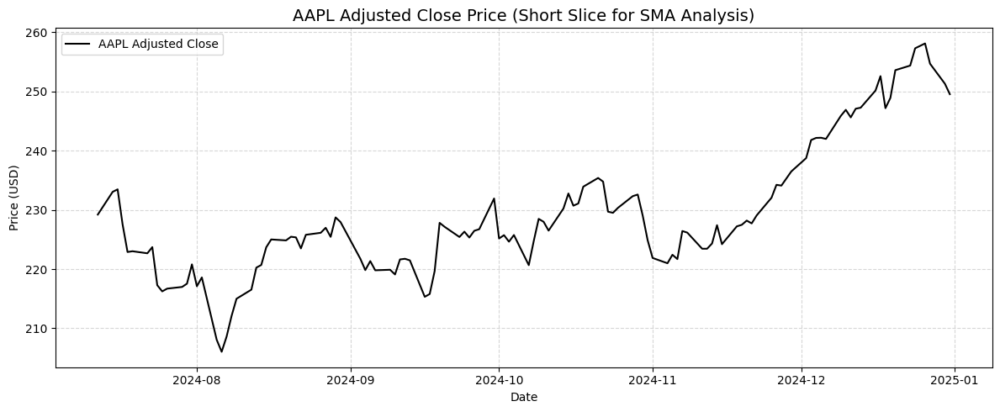

In [56]:
# %% Cell: Plot stock prices for SMA analysis
plt.figure(figsize=(12,5))
plt.plot(prices_short.index, prices_short.values, color='black', linewidth=1.5, label=f'{symbol} Adjusted Close')
plt.title(f'{symbol} Adjusted Close Price (Short Slice for SMA Analysis)', fontsize=14)
plt.xlabel('Date')
plt.ylabel('Price (USD)')
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.savefig('price_series.png', dpi=150)
plt.show()

### The Simple Moving Average (SMA)


For a price series P_t, the SMA of window n at time t is:


$$ SMA_t = \frac{1}{n} \sum_{i=0}^{n-1} P_{t-i} $$


It is a discrete-time convolution with a uniform kernel. In trading we can build a simple rule:
- Go long when price crosses above SMA ($ price_t > SMA_t $)
- Exit (go flat) when price crosses below SMA ( $ price_t < SMA_t $)


**Objective function**: We will measure strategy performance by *cumulative return* produced by applying the daily position (1=in market, 0=out) to daily pct changes, then compounding.


Pseudocode for the full process follows in the next markdown cell.

## Simulated Annealing Pseudocode (high level)

1. INPUT: price_series, candidate_window  
2. Compute SMA for candidate_window  
3. Generate signals: $signal_t = 1$ if $price_t > SMA_t$ else 0 
4. Compute daily returns $ r_t = (price_t / price_{t-1}) - 1 $ 
5. Strategy returns: $ sr_t = r_t * signal_{t-1} $  (use previous-day signal to avoid look-ahead)  
6. Cumulative $ performance = product(1 + sr_t) $ 
7. RETURN performance

Simulated annealing will repeatedly propose candidate_windows, evaluate the performance above, and accept/reject proposals based on temperature and the acceptance probability.


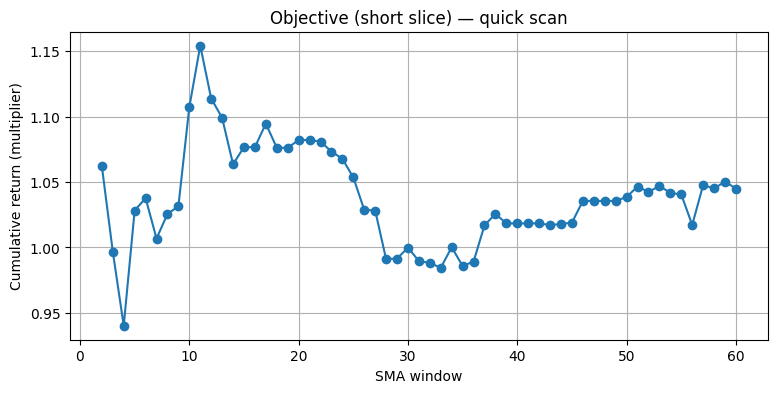

In [54]:
# %% Cell: Backtest and SMA utilities
def compute_sma(series, window):
    return series.rolling(window=window, min_periods=window).mean()

def backtest_cumulative_return(prices_series, window):
    sma = compute_sma(prices_series, window)
    signal = (prices_series > sma).astype(int).shift(1).fillna(0)
    returns = prices_series.pct_change().fillna(0)
    strat_returns = returns * signal
    return (1 + strat_returns).cumprod().iloc[-1]

# Quick scan for windows 2..60
windows = list(range(2, 61))
perf = [backtest_cumulative_return(prices_short, w) for w in windows]

plt.figure(figsize=(9,4))
plt.plot(windows, perf, marker='o')
plt.xlabel('SMA window')
plt.ylabel('Cumulative return (multiplier)')
plt.title('Objective (short slice) — quick scan')
plt.grid(True)
plt.savefig('quick_scan.png', dpi=150)
plt.show()


In [49]:
# %% Cell: Simulated Annealing for SMA optimization
import math
import random

def simulated_annealing_search(prices_series, window_min=2, window_max=60,
                               initial_temp=5.0, cooling_rate=0.998,
                               iterations=2000, max_neighbor_radius=5,
                               seed=42):
    random.seed(seed)
    np.random.seed(seed)
    
    current = random.randint(window_min, window_max)
    current_score = backtest_cumulative_return(prices_series, current)
    best, best_score = current, current_score
    history = []
    temp = initial_temp

    for i in range(iterations):
        radius = max(1, int(max_neighbor_radius * (1 - i / iterations)))
        proposal = int(np.clip(current + random.randint(-radius, radius), window_min, window_max))
        proposal_score = backtest_cumulative_return(prices_series, proposal)
        delta = proposal_score - current_score

        accept = delta > 0 or (temp > 0 and math.exp(delta / temp) > random.random())
        if accept:
            current, current_score = proposal, proposal_score
        if proposal_score > best_score:
            best, best_score = proposal, proposal_score

        history.append({
            'iter': i,
            'temp': temp,
            'current': current,
            'current_score': current_score,
            'proposal': proposal,
            'proposal_score': proposal_score,
            'best': best,
            'best_score': best_score
        })
        temp *= cooling_rate

    return best, best_score, history

# Multi-start search
best_overall, best_score_overall, all_histories = None, -np.inf, []
for seed in range(5):
    best_w, best_score, history = simulated_annealing_search(prices_short, seed=seed)
    all_histories.append(history)
    if best_score > best_score_overall:
        best_overall, best_score_overall = best_w, best_score

print("Best overall SMA window:", best_overall)
print("Best overall performance:", best_score_overall)

# Fine grid search around best
windows_to_check = range(max(2, best_overall-5), min(60, best_overall+5)+1)
scores = [backtest_cumulative_return(prices_short, w) for w in windows_to_check]
best_refined = windows_to_check[np.argmax(scores)]
print("Refined best SMA window:", best_refined)
print("Refined best performance:", max(scores))


Best overall SMA window: 11
Best overall performance: 1.1541562598290387
Refined best SMA window: 11
Refined best performance: 1.1541562598290387


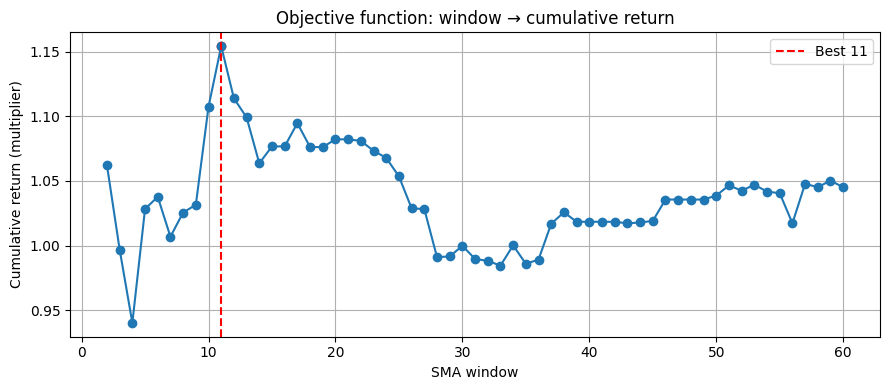

In [55]:
# Objective scan plot with best marker
plt.figure(figsize=(9,4))
plt.plot(windows, perf, marker='o')
plt.axvline(best_w, color='red', linestyle='--', label=f'Best {best_w}')
plt.scatter([best_w], [backtest_cumulative_return(prices_short, best_w)], color='red')
plt.xlabel('SMA window')
plt.ylabel('Cumulative return (multiplier)')
plt.title('Objective function: window → cumulative return')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('objective_with_best.png', dpi=150)
plt.show()


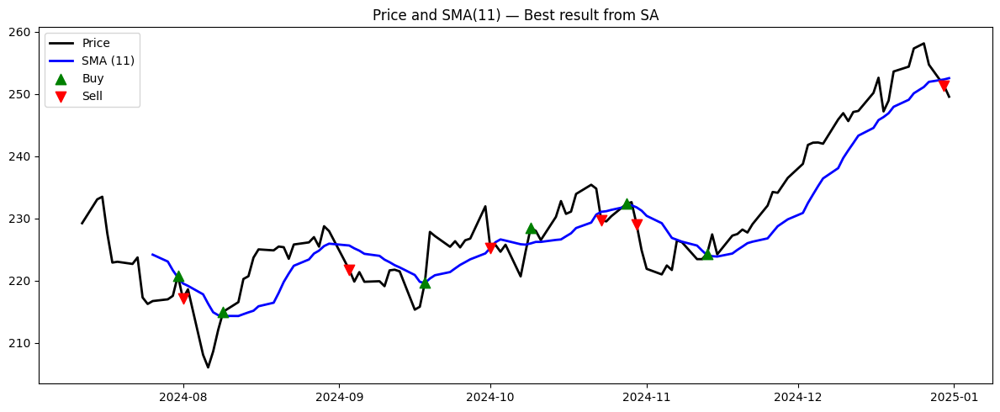

In [53]:
# %% Cell: Plot best SMA and buy/sell signals
def generate_signals(prices_series, window):
    sma = compute_sma(prices_series, window)
    signal = pd.Series(0, index=prices_series.index)
    signal[(prices_series > sma) & (prices_series.shift(1) <= sma.shift(1))] = 1
    signal[(prices_series < sma) & (prices_series.shift(1) >= sma.shift(1))] = -1
    return signal

sma_best = compute_sma(prices_short, best_overall)
signals_best = generate_signals(prices_short, best_overall)

plt.figure(figsize=(12,5))
plt.plot(prices_short.index, prices_short.values, label='Price', linewidth=2, color="black")
plt.plot(sma_best.index, sma_best.values, label=f'SMA ({best_overall})', linewidth=2, color="blue")
plt.scatter(prices_short.index[signals_best==1], prices_short[signals_best==1], marker='^', color='green', label='Buy', s=80, zorder=10)
plt.scatter(prices_short.index[signals_best==-1], prices_short[signals_best==-1], marker='v', color='red', label='Sell', s=80, zorder=10)
plt.legend()
plt.title(f'Price and SMA({best_overall}) — Best result from SA')
plt.tight_layout()
plt.savefig('sma_best_signals.png')
plt.show()

In [41]:
# %% Cell: Precompute SMA and signals for all windows in SA history
all_windows = set()
for history in all_histories:
    all_windows.update([h['current'] for h in history])
    all_windows.update([h['proposal'] for h in history])
    all_windows.update([h['best'] for h in history])

sma_cache = {}
signals_cache = {}
for w in all_windows:
    sma_cache[w] = compute_sma(prices_short, w)
    sig = pd.Series(0, index=prices_short.index)
    sig[(prices_short > sma_cache[w]) & (prices_short.shift(1) <= sma_cache[w].shift(1))] = 1
    sig[(prices_short < sma_cache[w]) & (prices_short.shift(1) >= sma_cache[w].shift(1))] = -1
    signals_cache[w] = sig


Rendering animation frames: 100%|█████████████████████| 2000/2000 [08:42<00:00,  3.83it/s]
Animation size has reached 20988913 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


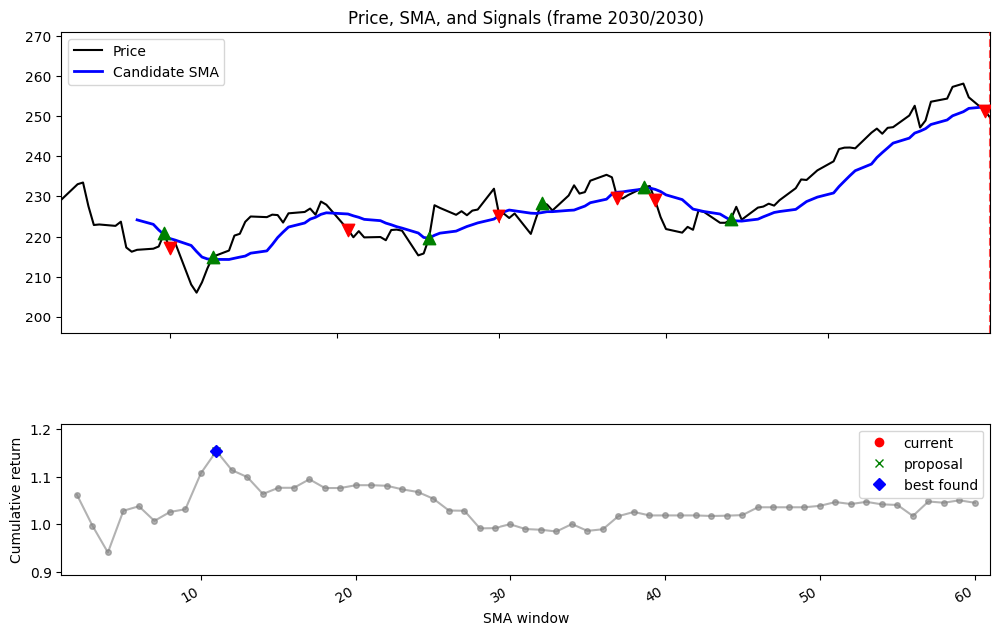

In [43]:
# %% Cell: Animation of SMA optimization (ending at optimal and saving)
from IPython.display import HTML
import matplotlib.dates as mdates
from tqdm import tqdm

history = all_histories[-1]  # last SA run

# Extract arrays
currents = [h['current'] for h in history]
proposals = [h['proposal'] for h in history]
bests = [h['best'] for h in history]
current_scores = [h['current_score'] for h in history]
proposal_scores = [h['proposal_score'] for h in history]
best_scores_hist = [h['best_score'] for h in history]

full_windows = list(range(2, 61))
full_perf = [backtest_cumulative_return(prices_short, w) for w in full_windows]

fig, (ax_price, ax_obj) = plt.subplots(2,1, figsize=(12,8), gridspec_kw={'height_ratios':[2,1]})
plt.subplots_adjust(hspace=0.4)
dates_num = mdates.date2num(prices_short.index)

# Price subplot
line_price, = ax_price.plot(dates_num, prices_short.values, color='black', label='Price', zorder=1)
line_sma, = ax_price.plot([], [], color='blue', linewidth=2, label='Candidate SMA', zorder=2)
iter_marker, = ax_price.plot([], [], 'r--', linewidth=1.5, alpha=0.7, zorder=5)
buy_scatter = ax_price.scatter([], [], marker='^', color='green', s=80, zorder=10)
sell_scatter = ax_price.scatter([], [], marker='v', color='red', s=80, zorder=10)
ax_price.legend()
ax_price.set_xlim(dates_num.min(), dates_num.max())
ax_price.set_ylim(prices_short.min()*0.95, prices_short.max()*1.05)
ax_price.xaxis_date()
ax_price.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
fig.autofmt_xdate()

# Objective subplot
ax_obj.plot(full_windows, full_perf, '-o', alpha=0.6, markersize=4, color='gray')
point_current, = ax_obj.plot([], [], 'ro', label='current')
point_proposal, = ax_obj.plot([], [], 'gx', label='proposal')
point_best, = ax_obj.plot([], [], 'bD', label='best found')
ax_obj.set_xlabel('SMA window')
ax_obj.set_ylabel('Cumulative return')
ax_obj.legend()
ax_obj.set_xlim(min(full_windows)-1, max(full_windows)+1)
ax_obj.set_ylim(min(full_perf)*0.95, max(full_perf)*1.05)

progress_bar = tqdm(total=len(history), desc="Rendering animation frames", ncols=90)

# Extend the animation by extra frames to hold optimal solution
extra_frames = 30
total_frames = len(history) + extra_frames

def init():
    line_sma.set_data([], [])
    iter_marker.set_data([], [])
    point_current.set_data([], [])
    point_proposal.set_data([], [])
    point_best.set_data([], [])
    buy_scatter.set_offsets(np.empty((0,2)))
    sell_scatter.set_offsets(np.empty((0,2)))
    return [line_sma, iter_marker, point_current, point_proposal, point_best, buy_scatter, sell_scatter]

def update(frame):
    if frame < len(history):
        progress_bar.update(1)
        cw = currents[frame]
        pw = proposals[frame]
        b = bests[frame]
        cs = current_scores[frame]
        ps = proposal_scores[frame]
        bs = best_scores_hist[frame]
    else:
        # Hold optimal solution
        cw = bests[-1]
        pw = bests[-1]
        b = bests[-1]
        cs = best_scores_hist[-1]
        ps = best_scores_hist[-1]
        bs = best_scores_hist[-1]
        if frame == total_frames-1:
            progress_bar.close()

    # SMA line
    sma_cw = sma_cache[cw]
    line_sma.set_data(dates_num, sma_cw.values)
    iter_marker.set_data([dates_num[-1], dates_num[-1]], [prices_short.min()*0.95, prices_short.max()*1.05])
    
    # Objective points
    point_current.set_data([cw], [cs])
    point_proposal.set_data([pw], [ps])
    point_best.set_data([b], [bs])
    
    # Buy/sell signals
    sig = signals_cache[cw]
    buy_idx = mdates.date2num(prices_short.index[sig==1])
    buy_vals = prices_short[sig==1].values
    sell_idx = mdates.date2num(prices_short.index[sig==-1])
    sell_vals = prices_short[sig==-1].values
    buy_scatter.set_offsets(np.column_stack([buy_idx, buy_vals]))
    sell_scatter.set_offsets(np.column_stack([sell_idx, sell_vals]))
    
    ax_price.set_title(f'Price, SMA, and Signals (frame {frame+1}/{total_frames})')
    return [line_sma, iter_marker, point_current, point_proposal, point_best, buy_scatter, sell_scatter]

ani = FuncAnimation(fig, update, frames=total_frames, init_func=init, blit=False, interval=50)

# Save animation
ani.save("sma_optimization_animation.mp4", writer='ffmpeg', fps=30)

HTML(ani.to_jshtml())


## Discussion & next steps

- **What we optimized:** a single hyperparameter — the SMA window length — to maximize *cumulative return* of a simple price-vs-SMA trading rule on a short BTC slice.
- **Why SA:** the objective surface (window → performance) is noisy and nonconvex. Simulated Annealing helps escape local optima by accepting worse solutions early with a probability that decays as temperature decreases.
- **Function outputs:** the SA function returns:
  - `best_window` — integer window that produced the top performance found,
  - `best_perf` — the cumulative return (multiplier) for that window,
  - `history` — detailed iteration records useful for visualization and diagnostics.

### Caveats and improvements
- This example **does not** include transaction costs, slippage, realistic execution rules, or position sizing. For realistic results, include those.
- Use *risk-adjusted* objectives (Sharpe, Sortino) or a multi-objective approach.
- Use walk-forward (out-of-sample) testing to reduce overfitting risk.
- For more robust search, try repeated SA runs with different seeds, or other global optimizers (genetic algorithms, Bayesian optimization) and compare.
